# Introduction

Problem: The Bank of Metis is currentl experiences losses due to increasing cred card defaults. I would like to present a solution to executive management: creaing a model to predict who will default. If we have a good idea of who will default, we can do something to try to prevent it (forebearance, consulting, etc.).
Goal: Predict whether or not a credit card client will default on their credit card \
Audience: Lending Executives

## Target

Default payment (Yes = 1, No = 0)

## Features

limit_bal: Amount of the given credit (NT dollar): it includes both the individual consumer credit and his/her family (supplementary) credit \
sex: Gender (1 = male; 2 = female) \
X3: Education (1 = graduate school; 2 = university; 3 = high school; 4 = others) \
X4: Marital status (1 = married; 2 = single; 3 = others) \
X5: Age (year) \
X6 - X11: History of past payment. We tracked the past monthly payment records (from April to September, 2005) as follows: The measurement scale for the repayment status is: -1 = pay duly; 1 = payment delay for one month; 2 = payment delay for two months; . . .; 8 = payment delay for eight months; 9 = payment delay for nine months and above \
X12-X17: Amount of bill statement (NT dollar). X12 = amount of bill statement in September, 2005; X13 = amount of bill statement in August, 2005; . . .; X17 = amount of bill statement in April, 2005 \
X18-X23: Amount of previous payment (NT dollar). X18 = amount paid in September, 2005; X19 = amount paid in August, 2005; . . .;X23 = amount paid in April, 2005

# Import Dependencies

In [2]:
import pandas as pd
import numpy as np
import psycopg2 as pg
import pickle

import matplotlib.pyplot as plt
import seaborn as sns
sns.set(style='white', palette = 'Paired')
#plt.style.use('ggplot')
%matplotlib inline
%config InlineBackend.figure_formats = ['svg']
np.set_printoptions(suppress=True) # Suppress scientific notation where possible
from ipywidgets import interactive, FloatSlider

from sklearn.inspection import permutation_importance
from sklearn import linear_model, svm, naive_bayes, neighbors, ensemble
from sklearn.model_selection import KFold, train_test_split, GridSearchCV, RandomizedSearchCV
from sklearn.neighbors import KNeighborsClassifier
from sklearn import metrics
from sklearn.preprocessing import StandardScaler, OneHotEncoder
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import SVC, LinearSVC
from sklearn.metrics import classification_report, plot_confusion_matrix, confusion_matrix,\
roc_auc_score, roc_curve, precision_recall_curve, f1_score, fbeta_score, recall_score,\
precision_recall_fscore_support

from sklearn.tree import DecisionTreeClassifier, DecisionTreeRegressor
from sklearn.ensemble import (RandomForestClassifier, ExtraTreesClassifier, VotingClassifier, 
                              AdaBoostClassifier, BaggingRegressor)
from sklearn.metrics import accuracy_score, make_scorer, log_loss

from imblearn.under_sampling import RandomUnderSampler
from imblearn.over_sampling import RandomOverSampler
from collections import Counter
from mlxtend.plotting import plot_decision_regions

import xgboost as xgb

# Import from PostgreSQL

In [3]:
# Postgres info to connect
connection_args = {
    'host': 'localhost',  # We are connecting to our _local_ version of psql
    'dbname': 'credit_default',    # DB that we are connecting to
    'port': 5432          # port we opened on AWS
}

connection = pg.connect(**connection_args)

In [4]:
query = "SELECT * FROM customers;"

df = pd.read_sql(query, connection)

# Data Preprocessing

In [5]:
# Rename Columns

In [6]:
# No null values!

In [7]:
# sex, education, and marriage are categorical variables and need to be converted into dummy variables

In [8]:
# Let's change the column names

In [9]:
history_names = {'pay_0':'Sep_Hist','pay_6':'Aug_Hist','pay_2':'Jul_Hist',
                 'pay_3':'Jun_Hist','pay_4':'May_Hist','pay_5':'Apr_Hist'}

In [10]:
df.rename(columns=history_names, inplace=True)

In [11]:
balance_names = {'bill_amt1':'Sep_Bal','bill_amt2':'Aug_Bal','bill_amt3':'Jul_Bal',
                 'bill_amt4':'Jun_Bal','bill_amt5':'May_Bal','bill_amt6':'Apr_Bal'}

In [12]:
df.rename(columns=balance_names, inplace=True)

In [13]:
payment_names = {'pay_amt1':'Sep_Pmt','pay_amt2':'Aug_Pmt','pay_amt3':'Jul_Pmt',
                 'pay_amt4':'Jun_Pmt','pay_amt5':'May_Pmt','pay_amt6':'Apr_Pmt'}

In [14]:
df.rename(columns=payment_names, inplace=True)

In [15]:
df.rename(columns={'default_payment_next_month':'Default'}, inplace=True)

In [16]:
# Remove ID column

df = df.loc[:,"limit_bal":'Default']

In [17]:
# Replace numbers with male, female

df['sex'].replace(to_replace='1', value='male', inplace=True)
df['sex'].replace(to_replace='2', value='female', inplace=True)

In [18]:
# Replace numbers with grad school, university, high school, and other

df['education'].replace(to_replace='1', value='gradschool', inplace=True)
df['education'].replace(to_replace='2', value='university', inplace=True)
df['education'].replace(to_replace='3', value='highschool', inplace=True)
df['education'].replace(to_replace='4', value='other', inplace=True)
df['education'].replace(to_replace='5', value='other', inplace=True)
df['education'].replace(to_replace='6', value='other', inplace=True)
df['education'].replace(to_replace='0', value='other', inplace=True)

In [19]:
# Replace numbers with married, single, and other

df['marriage'].replace(to_replace='1', value='married', inplace=True)
df['marriage'].replace(to_replace='2', value='single', inplace=True)
df['marriage'].replace(to_replace='3', value='other', inplace=True)
df['marriage'].replace(to_replace='0', value='other', inplace=True)

In [20]:
# Payment history is in a range of -2-8? Seems odd. Let's change the range to 0-10, makes more sense
print(sorted(df['Sep_Hist'].unique()))
print(sorted(df['Aug_Hist'].unique()))
print(sorted(df['Jul_Hist'].unique()))
print(sorted(df['Jun_Hist'].unique()))
print(sorted(df['May_Hist'].unique()))
print(sorted(df['Apr_Hist'].unique()))

[-2, -1, 0, 1, 2, 3, 4, 5, 6, 7, 8]
[-2, -1, 0, 2, 3, 4, 5, 6, 7, 8]
[-2, -1, 0, 1, 2, 3, 4, 5, 6, 7, 8]
[-2, -1, 0, 1, 2, 3, 4, 5, 6, 7, 8]
[-2, -1, 0, 1, 2, 3, 4, 5, 6, 7, 8]
[-2, -1, 0, 2, 3, 4, 5, 6, 7, 8]


In [21]:
# Change payment history ranges

df['Sep_Hist'].replace(to_replace=[-2, -1, 0, 1, 2, 3, 4, 5, 6, 7, 8],
                       value=[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10], inplace=True)
df['Aug_Hist'].replace(to_replace=[-2, -1, 0, 1, 2, 3, 4, 5, 6, 7, 8],
                       value=[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10], inplace=True)
df['Jul_Hist'].replace(to_replace=[-2, -1, 0, 1, 2, 3, 4, 5, 6, 7, 8],
                       value=[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10], inplace=True)
df['Jun_Hist'].replace(to_replace=[-2, -1, 0, 1, 2, 3, 4, 5, 6, 7, 8],
                       value=[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10], inplace=True)
df['May_Hist'].replace(to_replace=[-2, -1, 0, 1, 2, 3, 4, 5, 6, 7, 8],
                       value=[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10], inplace=True)
df['Apr_Hist'].replace(to_replace=[-2, -1, 0, 1, 2, 3, 4, 5, 6, 7, 8],
                       value=[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10], inplace=True)

In [22]:
print(sorted(df['Sep_Hist'].unique()))
print(sorted(df['Aug_Hist'].unique()))
print(sorted(df['Jul_Hist'].unique()))
print(sorted(df['Jun_Hist'].unique()))
print(sorted(df['May_Hist'].unique()))
print(sorted(df['Apr_Hist'].unique()))

[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10]
[0, 1, 2, 4, 5, 6, 7, 8, 9, 10]
[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10]
[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10]
[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10]
[0, 1, 2, 4, 5, 6, 7, 8, 9, 10]


In [25]:
# Save datarame to a CSV for use in Tableau

df.to_csv('/Users/dominguez/Documents/project3/Data/df.csv')

In [26]:
# Pickling the dataframe

with open('/Users/dominguez/Documents/project3/web_app/df.pickle', 'wb') as to_write:
    pickle.dump(df, to_write)

# Exploratory Data Analysis

In [25]:
df.head()

,limit_bal,sex,education,marriage,age,Sep_Hist,Jul_Hist,Jun_Hist,May_Hist,Apr_Hist,...,Jun_Bal,May_Bal,Apr_Bal,Sep_Pmt,Aug_Pmt,Jul_Pmt,Jun_Pmt,May_Pmt,Apr_Pmt,Default
0,20000,female,university,married,24,4,4,1,1,0,...,0,0,0,0,689,0,0,0,0,1
1,120000,female,university,single,26,1,4,2,2,2,...,3272,3455,3261,0,1000,1000,1000,0,2000,1
2,90000,female,university,single,34,2,2,2,2,2,...,14331,14948,15549,1518,1500,1000,1000,1000,5000,0
3,50000,female,university,married,37,2,2,2,2,2,...,28314,28959,29547,2000,2019,1200,1100,1069,1000,0
4,50000,male,university,married,57,1,2,1,2,2,...,20940,19146,19131,2000,36681,10000,9000,689,679,0


In [49]:
# Visualize Distributions/Correlations

In [26]:
default_corr = df.corr()['Default']

In [27]:
default_corr.drop(['Jul_Hist','Jun_Hist','May_Hist','Apr_Hist',
                   'Jul_Bal','Jun_Bal','May_Bal','Apr_Bal','Jul_Pmt','Jun_Pmt',
                   'May_Pmt','Apr_Pmt','Default'],axis=0, inplace=True)

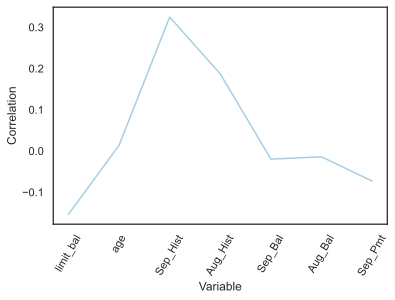

In [28]:
plt.xticks(rotation=60)
plt.xlabel('Variable')
plt.ylabel('Correlation')
plt.plot(default_corr[:-1],);

In [29]:
# Correlation between September payments history and default?

sns.pairplot(df[['Default', 'Sep_Hist']],height=4);

In [31]:
# What is distribution of Monthly History for defaults?

df_d = df[df['Default'] == 1]

In [32]:
sep_hist_list = df_d['Sep_Hist'].value_counts()

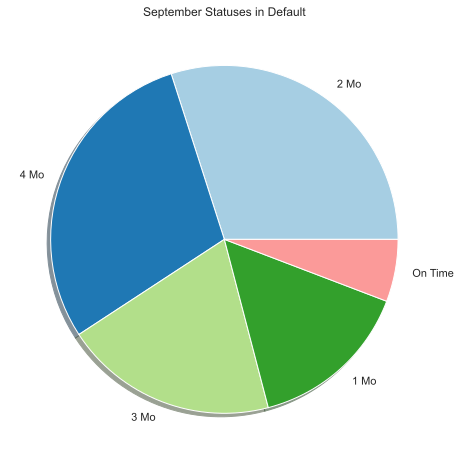

In [33]:
# Plot share in pie chart

plt.figure(figsize=(12,8))
plt.title('September Statuses in Default')
plt.pie(sep_hist_list[:5], labels=['2 Mo','4 Mo','3 Mo','1 Mo','On Time'], shadow=True);

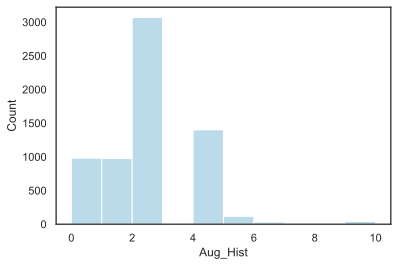

In [34]:
sns.histplot(df_d['Aug_Hist'], bins=10);

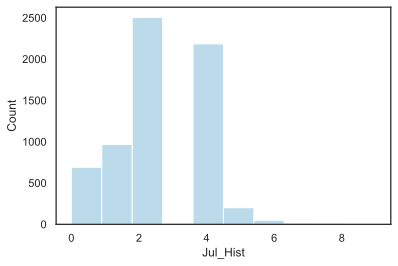

In [35]:
sns.histplot(df_d['Jul_Hist'], bins=10);

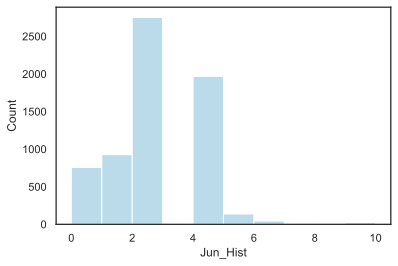

In [36]:
sns.histplot(df_d['Jun_Hist'], bins=10);

In [ ]:
# Credit cards in default tend to already be in default 2-4 months

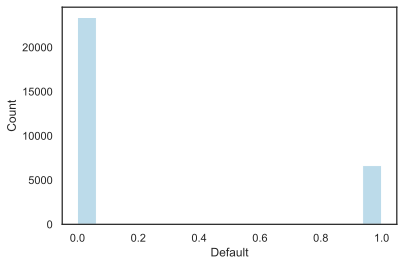

In [37]:
sns.histplot(df['Default'], kde=False);

In [ ]:
# Highly imbalanced dataset

In [38]:
sns.pairplot(df[['Default', 'limit_bal']],height=4);

In [ ]:
# Bulk of the balances are $0-$300k
# Clasess are well distributed amongst limit balances

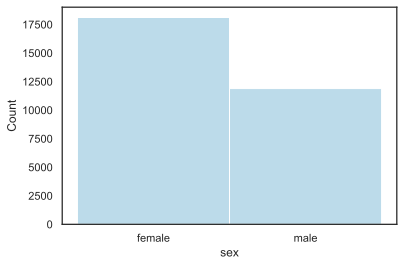

In [39]:
sns.histplot(df['sex'],bins=2, kde=False);

In [ ]:
# Most are female

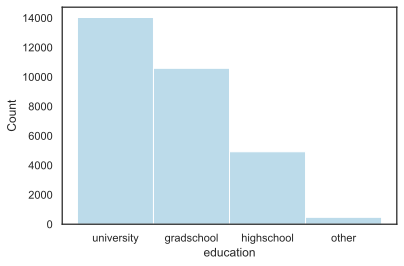

In [40]:
sns.histplot(df['education'],bins=2, kde=False);

In [ ]:
# Most have graduate and unversity educations

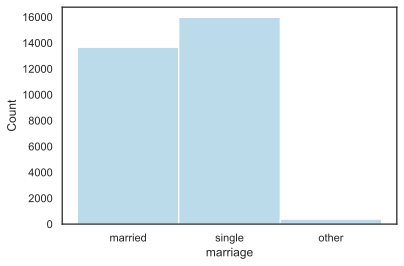

In [41]:
sns.histplot(df['marriage'],bins=4, kde=False);

In [ ]:
# Mostly even between single/married

In [42]:
sns.pairplot(df[['Default', 'age']], height=4);

In [ ]:
# Mostly mid 20s - late 30s/early 40s

# Minimum Viable Product

In [43]:
# Establish features and target variables

X = df.loc[:,'limit_bal':'Apr_Pmt']

y = df['Default']

In [44]:
# Encoding categorical variables

categoricals = ['sex','education','marriage']
numericals = ['limit_bal','age','Sep_Hist','Jul_Hist', 'Jun_Hist', 'May_Hist', 'Apr_Hist',
              'Aug_Hist', 'Sep_Bal','Aug_Bal', 'Jul_Bal', 'Jun_Bal', 'May_Bal', 'Apr_Bal', 'Sep_Pmt',
              'Aug_Pmt', 'Jul_Pmt', 'Jun_Pmt', 'May_Pmt', 'Apr_Pmt']

ohe = OneHotEncoder(sparse=False, drop='first')
cat_matrix = ohe.fit_transform(X.loc[:, categoricals])
X_ohe = pd.DataFrame(cat_matrix,
                       columns=ohe.get_feature_names(categoricals), #create meaningful column names
                       index=X.index) #keep the same index values
X = pd.concat([X.loc[:, numericals], X_ohe], axis=1)

In [45]:
# hold out 20% of the data for final testing
X, X_test, y, y_test = train_test_split(X, y, test_size=.2, random_state=42)

# Split train and validate sets
X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=.25, random_state=42)

#this helps with the way kf will generate indices below
X, y = np.array(X), np.array(y)

In [46]:
# Scale features

scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_val_scaled = scaler.transform(X_val)

In [47]:
# Validate

# Knn
knn = KNeighborsClassifier(n_neighbors=5)
knn.fit(X_train_scaled,y_train)
print(f'KNN score: {knn.score(X_val_scaled,y_val)}')

# Logistic Regression
lr = LogisticRegression(penalty='none')
lr.fit(X_train_scaled,y_train)
print(f'Logistic Regression score: {lr.score(X_val_scaled,y_val)}')

# Random Forest
rf = RandomForestClassifier()
rf.fit(X_train_scaled,y_train)
print(f'Random Forest score: {rf.score(X_val_scaled,y_val)}')

# XGBoost
gbm = xgb.XGBClassifier( )
gbm.fit(X_train_scaled,y_train)
print(f'XGBoost score: {gbm.score(X_val_scaled,y_val)}')

# SVC
svc = SVC(probability=True)
svc.fit(X_train_scaled,y_train)
print(f'SVC score: {svc.score(X_val_scaled,y_val)}')

KNN score: 0.7961666666666667
Logistic Regression score: 0.8158333333333333
Random Forest score: 0.8185
XGBoost score: 0.8175
SVC score: 0.8198333333333333


In [48]:
# Test

# Scale test data

X_test_scaled = scaler.transform(X_test)

# Knn
print(f'KNN test score: {knn.score(X_test_scaled,y_test)}')

# Logistic Regression
print(f'Logistic Regression test score: {lr.score(X_test_scaled,y_test)}')

# Random Forest
print(f'Random Forest test score: {rf.score(X_test_scaled,y_test)}')

# XGBoost
print(f'XGBoost test score: {gbm.score(X_test_scaled,y_test)}')

# SVC
print(f'SVC test score: {svc.score(X_test_scaled,y_test)}')

KNN test score: 0.7928333333333333
Logistic Regression test score: 0.8103333333333333
Random Forest test score: 0.815
XGBoost test score: 0.8156666666666667
SVC test score: 0.8173333333333334


In [ ]:
# Random Forest and SVC are the 'best' simple models
# Since SVC takes forever to run, I will go with Random Forest and build on it

## Feature Imporance

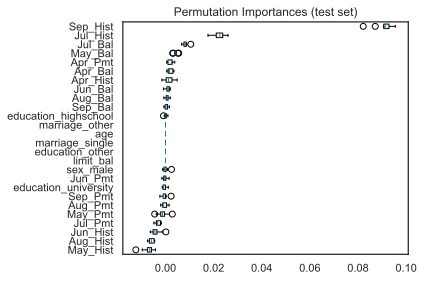

In [49]:
result = permutation_importance(rf, X_test, y_test, n_repeats=10,
                                random_state=42, n_jobs=2)
sorted_idx = result.importances_mean.argsort()

fig, ax = plt.subplots()
ax.boxplot(result.importances[sorted_idx].T,
           vert=False, labels=X_test.columns[sorted_idx])
ax.set_title("Permutation Importances (test set)")
fig.tight_layout()
plt.show()

## Performance Metrics

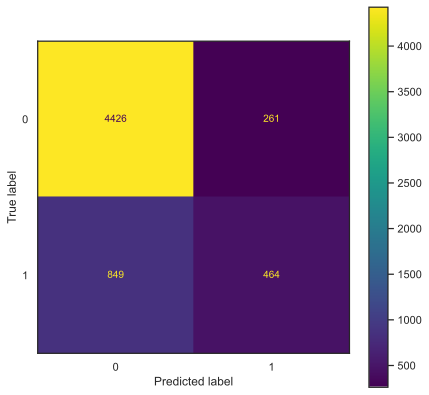

In [50]:
# Random Forest Confusion Matrix

fig, ax = plt.subplots(figsize=(7, 7))
plot_confusion_matrix(rf, X_test_scaled, y_test, ax=ax);

In [51]:
# Random Forest Classification Report

y_preds_rf = rf.predict(X_test_scaled)

print(classification_report(y_test, y_preds_rf))

              precision    recall  f1-score   support

           0       0.84      0.94      0.89      4687
           1       0.64      0.35      0.46      1313

    accuracy                           0.81      6000
   macro avg       0.74      0.65      0.67      6000
weighted avg       0.80      0.81      0.79      6000



In [ ]:
# False Negative - incorrectly predicted person will not default when in fact they did
# False Positive - incorrectly predicted person will default when in fact they didn't

# False Negatives are more detrimental to a financial institution because it leads to higher losses.
#   Higher number of defaults would slip through the cracks, forcing the bank to eat those losses
#   We want to optimize Recall (TP/TP + FN)

# Hyperparameter Tuning

In [52]:
# Define the parameter values that should be searched

bootstrap = [True, False]
max_features = ['auto','sqrt']
min_samples_leaf = [1,2,4]
min_samples_split = [2,5,10]
n_estimators = [50,100,150,200]
max_depth = [4,6,10,12, None]

In [53]:
# Specify "parameter distributions" rather than a "parameter grid"

param_dist = dict(n_estimators=n_estimators, max_depth = max_depth, bootstrap=bootstrap,
                  min_samples_leaf=min_samples_leaf,min_samples_split=min_samples_split,
                  max_features=max_features)
print(param_dist)

{'n_estimators': [50, 100, 150, 200], 'max_depth': [4, 6, 10, 12, None], 'bootstrap': [True, False], 'min_samples_leaf': [1, 2, 4], 'min_samples_split': [2, 5, 10], 'max_features': ['auto', 'sqrt']}


In [54]:
# n_iter controls the number of searches

rand = RandomizedSearchCV(RandomForestClassifier(), param_dist, cv=10, scoring='accuracy',
                          n_iter=10, random_state=42)
rand.fit(X_train_scaled, y_train)
rand.cv_results_

{'mean_fit_time': array([1.59225771, 4.85903649, 1.47006149, 2.9393867 , 1.86628606,
        0.94014406, 1.86066279, 1.94937031, 1.60692148, 1.95894654]),
 'std_fit_time': array([0.10610466, 0.07835703, 0.10669001, 0.05092772, 0.03161781,
        0.01156567, 0.01973228, 0.01377973, 0.01366722, 0.02844007]),
 'mean_score_time': array([0.01767371, 0.054421  , 0.02171884, 0.0332808 , 0.01658592,
        0.01446579, 0.0279155 , 0.02207553, 0.01786566, 0.02135835]),
 'std_score_time': array([0.00168665, 0.00205101, 0.00038836, 0.00388388, 0.00034965,
        0.00040263, 0.00050941, 0.00158768, 0.00035706, 0.00050428]),
 'param_n_estimators': masked_array(data=[50, 150, 150, 150, 100, 100, 200, 100, 50, 150],
              mask=[False, False, False, False, False, False, False, False,
                    False, False],
        fill_value='?',
             dtype=object),
 'param_min_samples_split': masked_array(data=[5, 2, 5, 5, 10, 5, 2, 2, 5, 5],
              mask=[False, False, False, Fals

In [55]:
def get_best_model(model_grid):
    best_k = model_grid.cv_results_['rank_test_score'][0]
    print (f"Mean score: {model_grid.cv_results_['mean_test_score'][best_k]}",
           f"Std: {model_grid.cv_results_['std_test_score'][best_k]}")

In [56]:
# Examine the best model
print(rand.best_score_)
print(rand.best_params_)
get_best_model(rand)

0.8205
{'n_estimators': 100, 'min_samples_split': 10, 'min_samples_leaf': 2, 'max_features': 'auto', 'max_depth': 6, 'bootstrap': False}
Mean score: 0.8205 Std: 0.008942373811394608


# Dealing with Class Imbalance

## Under/Oversampling

In [61]:
# Balance data by undersampling/oversampling. Training data in each fold. Validating/testing on untouched data

In [57]:
# Cross Validation

kf = KFold(n_splits=10, shuffle=True, random_state = 42)
rf_under_scores, rf_over_scores = [],[]
rus = RandomUnderSampler(random_state=42)

for train_ind, val_ind in kf.split(X,y):

    X_train, y_train = X[train_ind], y[train_ind]
    X_val, y_val = X[val_ind], y[val_ind]
    
    ros = RandomOverSampler()
    rus = RandomUnderSampler()
    
    # Create undersampling of the data
    X_train_under, y_train_under = rus.fit_sample(X_train, y_train)
    # Create oversampling of the data
    X_train_over, y_train_over = ros.fit_sample(X_train, y_train)
    
    # Scale the features
    scaler_under = StandardScaler()
    X_train_under_scaled = scaler_under.fit_transform(X_train_under)
    X_val_scaled = scaler_under.transform(X_val)
    
    scaler_over = StandardScaler()
    X_train_over_scaled = scaler_over.fit_transform(X_train_over)
    X_val_scaled = scaler_over.transform(X_val)
    
    # Random Forest - Undersampling
    rf_under = RandomForestClassifier(n_estimators=150, max_depth=10, min_samples_split=5,
                                      min_samples_leaf=2, bootstrap=True, max_features='sqrt')
    rf_under.fit(X_train_under_scaled, y_train_under)
    rf_under_scores.append(rf_under.score(X_val_scaled,y_val))
    
    # Random Forest - Oversampling
    rf_over = RandomForestClassifier(n_estimators=150, max_depth=10, min_samples_split=5,
                                      min_samples_leaf=2, bootstrap=True, max_features='sqrt')
    rf_over.fit(X_train_over_scaled, y_train_over)
    rf_over_scores.append(rf_over.score(X_val_scaled, y_val))
        
rf_val_under_score = round(np.mean(rf_under_scores),4)
rf_val_over_score = round(np.mean(rf_over_scores),4)

print(f'Random Forest undersampling val score: {rf_val_under_score}')
print(f'Random forest oversampling val score: {rf_val_over_score}')

Random Forest undersampling val score: 0.766
Random forest oversampling val score: 0.781


In [58]:
# Test

X_test_scaled = scaler.transform(X_test)

print(f'Random forest undersampling test score: {rf_under.score(X_test_scaled,y_test)}')
print(f'Random forest oversampling test score: {rf_over.score(X_test_scaled,y_test)}')

Random forest undersampling test score: 0.7586666666666667
Random forest oversampling test score: 0.7783333333333333


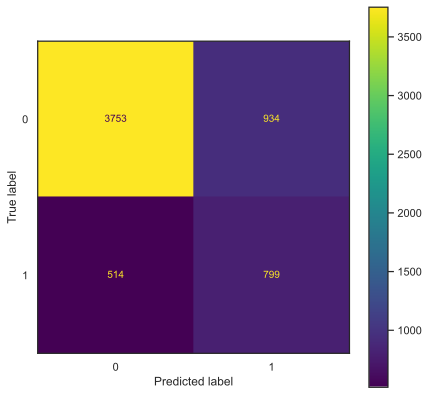

In [59]:
# Confusion Matrices
# Undrsampling
fig, ax = plt.subplots(figsize=(7, 7))
plot_confusion_matrix(rf_under, X_test_scaled, y_test, ax=ax);

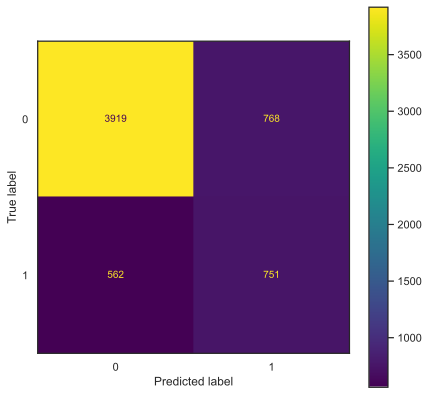

In [60]:
# Oversampling
fig, ax = plt.subplots(figsize=(7, 7))
plot_confusion_matrix(rf_over, X_test_scaled, y_test, ax=ax);

In [61]:
# Classification Report

y_preds_rf_under = rf_under.predict(X_test_scaled)

print(classification_report(y_test, y_preds_rf_under))

              precision    recall  f1-score   support

           0       0.88      0.80      0.84      4687
           1       0.46      0.61      0.52      1313

    accuracy                           0.76      6000
   macro avg       0.67      0.70      0.68      6000
weighted avg       0.79      0.76      0.77      6000



In [62]:
y_preds_rf_over = rf_over.predict(X_test_scaled)

print(classification_report(y_test, y_preds_rf_over))

              precision    recall  f1-score   support

           0       0.87      0.84      0.85      4687
           1       0.49      0.57      0.53      1313

    accuracy                           0.78      6000
   macro avg       0.68      0.70      0.69      6000
weighted avg       0.79      0.78      0.78      6000



In [63]:
# F_beta scores

print(f"Fbeta score Undersampled: {fbeta_score(y_test, y_preds_rf_under, average='weighted', beta=3.0)}")
print(f"Fbeta score Oversampled: {fbeta_score(y_test, y_preds_rf_over, average='weighted', beta=3.0)}")

Fbeta score Undersampled: 0.7601947502704305
Fbeta score Oversampled: 0.7792833240740844


In [ ]:
# We want an F_beta score of >1 to make sure the model favors recall

In [64]:
# Log Loss Cross-Entropy Scores

print("Log-loss score Undersampled: {:6.4f}".format(log_loss(y_test, rf_under.predict_proba(X_test_scaled))))
print("Log-loss score Oversampled: {:6.4f}".format(log_loss(y_test, rf_over.predict_proba(X_test_scaled))))

Log-loss score Undersampled: 0.5602
Log-loss score Oversampled: 0.5361


## Threshold Analysis

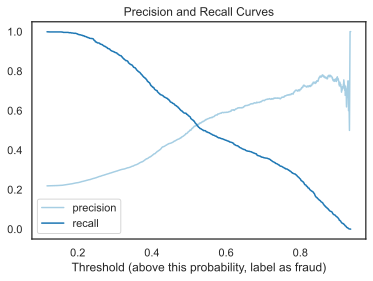

In [65]:
# Precision/Recall Curves

precision_curve, recall_curve, threshold_curve = precision_recall_curve(y_test, 
                                                                        rf_over.predict_proba(X_test_scaled)[:,1])

plt.figure(dpi=80)
plt.plot(threshold_curve, precision_curve[1:],label='precision')
plt.plot(threshold_curve, recall_curve[1:], label='recall')
plt.legend(loc='lower left')
plt.xlabel('Threshold (above this probability, label as fraud)');
plt.title('Precision and Recall Curves');

In [66]:
def make_confusion_matrix(model, threshold=0.5):
    """
    Predict class 1 if probability of being in class 1 is greater than threshold
    (model.predict(X_test) does this automatically with a threshold of 0.5)
    """
    y_predict = (model.predict_proba(X_test_scaled)[:, 1] >= threshold)
    fraud_confusion = confusion_matrix(y_test, y_predict)
    plt.figure(dpi=80)
    sns.heatmap(fraud_confusion, cmap=plt.cm.Blues, annot=True, square=True, fmt='d',
           xticklabels=['legit', 'fraud'],
           yticklabels=['legit', 'fraud']);
    plt.xlabel('prediction')
    plt.ylabel('actual')

In [67]:
# Interactive Confusion matrix

interactive(lambda threshold: make_confusion_matrix(rf_under, threshold), threshold=(0.0,1.0,0.02))

interactive(children=(FloatSlider(value=0.5, description='threshold', max=1.0, step=0.02), Output()), _dom_cla…

In [ ]:
# Since we want recall to have a higher importance than precision, we can set threshold to somewhere around 0.4

In [ ]:
# Scenario 1: Low Threshold to capture recall
# Scenario 2: Mid Threshold to get a good balance
# Scenario 1: High Threshold to capture precision

In [68]:
# Cross Validation

kf = KFold(n_splits=10, shuffle=True, random_state = 42)
rf_under_scores_low, rf_under_scores_mid, rf_under_scores_high = [],[],[]
rus = RandomOverSampler(random_state=42)
thresh_low = 0.10
thresh_mid = 0.40
thresh_high = 0.90

for train_ind, val_ind in kf.split(X,y):

    X_train, y_train = X[train_ind], y[train_ind]
    X_val, y_val = X[val_ind], y[val_ind]
    
    # Undersample the data
    X_train_under, y_train_under = rus.fit_sample(X_train, y_train)
    
    # Scale the features
    scaler = StandardScaler()
    X_train_under_scaled = scaler.fit_transform(X_train_under)
    X_val_scaled = scaler.transform(X_val)
    
    # Random Forest
    rf_under = RandomForestClassifier(n_estimators=150, max_depth=10, min_samples_split=5,
                                      min_samples_leaf=2, bootstrap=True, max_features='sqrt')
    rf_under.fit(X_train_under_scaled, y_train_under)
    rf_under_scores_low.append(accuracy_score(y_val, rf_under.predict_proba(X_val_scaled)[:,1]>thresh_low))
    rf_under_scores_mid.append(accuracy_score(y_val, rf_under.predict_proba(X_val_scaled)[:,1]>thresh_mid))
    rf_under_scores_high.append(accuracy_score(y_val, rf_under.predict_proba(X_val_scaled)[:,1]>thresh_high))
        
rf_val_under_score_low = round(np.mean(rf_under_scores_low),4)
rf_val_under_score_mid = round(np.mean(rf_under_scores_mid),4)
rf_val_under_score_high = round(np.mean(rf_under_scores_high),4)

print(f'Random forest oversampling, low threshold val score: {rf_val_under_score_low}')
print(f'Random forest oversampling, mid threshold val score: {rf_val_under_score_mid}')
print(f'Random forest oversampling, high threshold val score: {rf_val_under_score_high}')

Random forest oversampling, low threshold val score: 0.222
Random forest oversampling, mid threshold val score: 0.7057
Random forest oversampling, high threshold val score: 0.7916


In [69]:
# Test

X_test_scaled = scaler.transform(X_test)

print(f'Random forest oversampling, low threshold test score: {accuracy_score(y_test, rf_under.predict_proba(X_test_scaled)[:,1]>thresh_low)}')
print(f'Random forest oversampling, mid threshold test score: {accuracy_score(y_test, rf_under.predict_proba(X_test_scaled)[:,1]>thresh_mid)}')
print(f'Random forest oversampling, high threshold test score: {accuracy_score(y_test, rf_under.predict_proba(X_test_scaled)[:,1]>thresh_high)}')

Random forest oversampling, low threshold test score: 0.22
Random forest oversampling, mid threshold test score: 0.697
Random forest oversampling, high threshold test score: 0.7915


In [70]:
# Classification Report with low threshold

print(classification_report(y_test, rf_under.predict_proba(X_test_scaled)[:,1]>thresh_low))

              precision    recall  f1-score   support

           0       1.00      0.00      0.00      4687
           1       0.22      1.00      0.36      1313

    accuracy                           0.22      6000
   macro avg       0.61      0.50      0.18      6000
weighted avg       0.83      0.22      0.08      6000



In [71]:
# Classification Report with mid threshold

print(classification_report(y_test, rf_under.predict_proba(X_test_scaled)[:,1]>thresh_mid))

              precision    recall  f1-score   support

           0       0.89      0.70      0.78      4687
           1       0.39      0.69      0.50      1313

    accuracy                           0.70      6000
   macro avg       0.64      0.70      0.64      6000
weighted avg       0.78      0.70      0.72      6000



In [72]:
# Classification Report with mid threshold

print(classification_report(y_test, rf_under.predict_proba(X_test_scaled)[:,1]>thresh_high))

              precision    recall  f1-score   support

           0       0.79      0.99      0.88      4687
           1       0.75      0.07      0.13      1313

    accuracy                           0.79      6000
   macro avg       0.77      0.53      0.50      6000
weighted avg       0.78      0.79      0.72      6000



In [73]:
# F_beta scores

print(fbeta_score(y_test, rf_under.predict_proba(X_test_scaled)[:,1]>thresh_low, average='weighted', beta=3.0))
print(fbeta_score(y_test, rf_under.predict_proba(X_test_scaled)[:,1]>thresh_mid, average='weighted', beta=1.0))
print(fbeta_score(y_test, rf_under.predict_proba(X_test_scaled)[:,1]>thresh_high, average='weighted', beta=0.2))

0.16262576491817518
0.7208278537252221
0.7437354741231839


In [74]:
# Log Loss Cross-Entropy Score

print("Log-loss on logit: {:6.4f}".format(log_loss(y_test, rf_under.predict_proba(X_test_scaled)[:,1]>thresh_low)))
print("Log-loss on logit: {:6.4f}".format(log_loss(y_test, rf_under.predict_proba(X_test_scaled)[:,1]>thresh_mid)))
print("Log-loss on logit: {:6.4f}".format(log_loss(y_test, rf_under.predict_proba(X_test_scaled)[:,1]>thresh_high)))

Log-loss on logit: 26.9409
Log-loss on logit: 10.4654
Log-loss on logit: 7.2013


In [ ]:
# Presentation: present scenarios and apply potential $profits/$losses for each one

## Winner

Undersampling with Random Forest seems to have the highest recall rate. All models sacrifice True Positives in order to increase recall rate.

Furthermore, it makes more sense to use undersampling because it is less computationally expensive as I have 30,000 rows in my data

Trade-off question: Do we want high recall rate or strong true positives?

# Model for Deployment

## Important Features

The following features will be used for the deployed model

1. September History
2. August History
3. July History
4. June History

## Revised Model

In [75]:
# Establish features and target variables

X_rev = df[['Sep_Hist','Aug_Hist','Jul_Hist', 'Jun_Hist']]

y_rev = df['Default']

In [76]:
# hold out 20% of the data for final testing
X_rev, X_rev_test, y_rev, y_rev_test = train_test_split(X_rev, y_rev, test_size=.2, random_state=42)

# Split train and validate sets
X_rev_train, X_rev_val, y_rev_train, y_rev_val = train_test_split(X_rev, y_rev, test_size=.25, random_state=42)

#this helps with the way kf will generate indices below
X_rev, y_rev = np.array(X_rev), np.array(y_rev)

In [77]:
# Scale features

scaler = StandardScaler()
X_rev_train_scaled = scaler.fit_transform(X_rev_train)
X_rev_val_scaled = scaler.transform(X_rev_val)

In [78]:
# Pickle the scaler to be used in the web app

with open('/Users/dominguez/Documents/project3/web_app/scaler.pickle', 'wb') as to_write:
    pickle.dump(scaler, to_write)

In [79]:
# Oversampling Cross Validation

kf = KFold(n_splits=10, shuffle=True, random_state = 42)
rf_rev_scores = []
ros = RandomOverSampler(random_state=42)

for train_ind, val_ind in kf.split(X_rev,y_rev):

    X_train, y_train = X_rev[train_ind], y_rev[train_ind]
    X_val, y_val = X_rev[val_ind], y_rev[val_ind]
    
    # Undersample the data
    X_train_under, y_train_under = rus.fit_sample(X_train, y_train)
    
    # Scale the features
    scaler = StandardScaler()
    X_train_under_scaled = scaler.fit_transform(X_train_under)
    X_val_scaled = scaler.transform(X_val)
    
    # Random Forest
    rf_rev = RandomForestClassifier(n_estimators=150, max_depth=10, min_samples_split=5,
                                      min_samples_leaf=2, bootstrap=True, max_features='sqrt')
    rf_rev.fit(X_train_under_scaled, y_train_under)
    rf_rev_scores.append(rf_rev.score(X_val_scaled, y_val))
        
rf_val_rev_score = round(np.mean(rf_rev_scores),4)

print(f'Random forest oversampling val score: {rf_val_rev_score}')

Random forest oversampling val score: 0.7753


In [80]:
# Pickle trained model to use in web app

with open('/Users/dominguez/Documents/project3/web_app/rf_rev.pickle', 'wb') as to_write:
    pickle.dump(rf_rev, to_write)

In [81]:
# Test

X_rev_test_scaled = scaler.transform(X_rev_test)

print(f'Random forest oversampling test score: {rf_rev.score(X_rev_test_scaled,y_rev_test)}')

Random forest oversampling test score: 0.7803333333333333


# ROC Curve

ROC AUC score =  0.7764650519310027


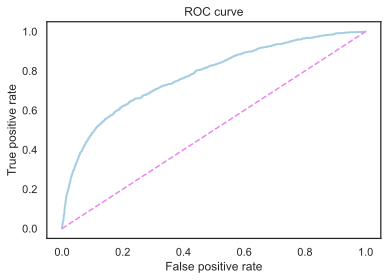

In [82]:
# ROC Curve

fpr, tpr, thresholds = roc_curve(y_test, rf_over.predict_proba(X_test_scaled)[:,1])

plt.plot(fpr, tpr,lw=2)
plt.plot([0,1],[0,1],c='violet',ls='--')
plt.xlim([-0.05,1.05])
plt.ylim([-0.05,1.05])


plt.xlabel('False positive rate')
plt.ylabel('True positive rate')
plt.title('ROC curve');
print("ROC AUC score = ", roc_auc_score(y_test, rf_over.predict_proba(X_test_scaled)[:,1]))